# Import

Code by CAF

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import astropy.units as u
from astropy import constants as const
import astropy.coordinates as coord
import pandas as pd
from decimal import Decimal

In [2]:
#from google.colab import drive
#drive.mount('/content/drive')

# Potential Plotting

In [3]:
# Parameter for disk modelling (Table 3. Barros, et al. 2016)
param = pd.read_csv('param.csv', delimiter=';')
param

,Component,Thin_disk,Thick_disk,HI_disk,H2_disk
0,M1,2.106,0.056,2.046,0.928
1,M2,2.162,3.766,2.169,0.163
2,M3,-1.704,-3.250,-3.049,-0.837
3,a1,3.859,0.993,9.021,6.062
4,a2,9.052,6.555,9.143,3.141
5,a3,3.107,7.651,7.758,4.485
6,b,0.243,0.776,0.168,0.128
7,Model,3.000,1.000,2.000,3.000


In [4]:
# Defining potential of each Galactic component
# x, y, z must be in kpc

def pot_disk(x, y, z):                                                          # Potential of disk component  
    param = pd.read_csv('param.csv', delimiter=';')                             # Eq (14 - 17) & Table 3. (Barros, et al. 2016)
    R = (x**2 + y**2)**0.5                                                      # This is madness, need a tidier code 
    G = const.G                                                                 # But it works for now
    M_thin = np.array(param.Thin_disk[0:3]) * 1E10 * u.M_sun
    M_thick = np.array(param.Thick_disk[0:3]) * 1E10 * u.M_sun
    M_HI = np.array(param.HI_disk[0:3]) * 1E10 * u.M_sun
    M_H2 = np.array(param.H2_disk[0:3]) * 1E10 * u.M_sun
    a_thin = np.array(param.Thin_disk[3:6]) * u.kpc
    a_thick = np.array(param.Thick_disk[3:6]) * u.kpc
    a_HI = np.array(param.HI_disk[3:6]) * u.kpc
    a_H2 = np.array(param.H2_disk[3:6]) * u.kpc

    def model(R, z, M, a, b, n):                                                
        if str(int(n)) == '1':
            m1 = 0
            m2 = 0
        elif str(int(n)) == '2':
            m1 = 1
            m2 = 0
        elif str(int(n)) == '3':
            m1 = 1
            m2 = 1
        zeta = (z**2 + b**2)**0.5
        pot = (- G * M / (R**2 + (a + zeta)**2)**0.5) * ((m1 * (1 + (a*(a + zeta) / (R**2 + (a + zeta)**2)))) - (m2 * (a**2 * (R**2 - 2 * (a + zeta)**2) / (3 * ((R**2 + (a + zeta)**2))**2))))
        return pot
   
    thin_pot = 0
    thick_pot = 0
    HI_pot = 0
    H2_pot = 0

    for i in range(3):
        thin_pot += model(R, z, M_thin[i], a_thin[i], param['Thin_disk'][6] * u.kpc, param['Thin_disk'][7])
        thick_pot += model(R, z, M_thick[i], a_thick[i], param['Thick_disk'][6] * u.kpc, param['Thick_disk'][7])
        HI_pot += model(R, z, M_HI[i], a_HI[i], param['HI_disk'][6] * u.kpc, param['HI_disk'][7])
        H2_pot += model(R, z, M_H2[i], a_H2[i], param['H2_disk'][6] * u.kpc, param['H2_disk'][7])

    disk_pot = thin_pot + thick_pot + HI_pot + H2_pot  
    return disk_pot.to((u.km / u.s)**2)

def pot_bulge(x, y, z):                                                         # Potential of bulge component
    R = ((x**2 + y**2)**0.5).to(u.kpc)                                          # Eq (19) (Barros, et al. 2016)
    M_b = 2.61E10 * u.M_sun
    a_b = 0.44 * u.kpc
    bulge_pot = - const.G * M_b / ((R**2 + z**2)**0.5 + a_b)
    return bulge_pot.to((u.km / u.s)**2)

def pot_halo(x, y, z):                                                          # Potential of dark halo component
    R = ((x**2 + y**2)**0.5).to(u.kpc)                                          # Eq (20) (Barros, et al. 2016) 
    q_phi = 1                                                                   
    v_h = 166 * u.km / u.second                                                 
    r_h = 5.4 * u.kpc
    halo_pot = v_h.value**2 * np.log(R.value**2 + (z.value**2 * q_phi**-2) + r_h.value**2) / 2 
    return halo_pot * (u.km / u.s)**2

def totpot(x, y, z):
    total = pot_halo(x, y, z) + pot_bulge(x, y, z) + pot_disk(x, y, z)
    return total


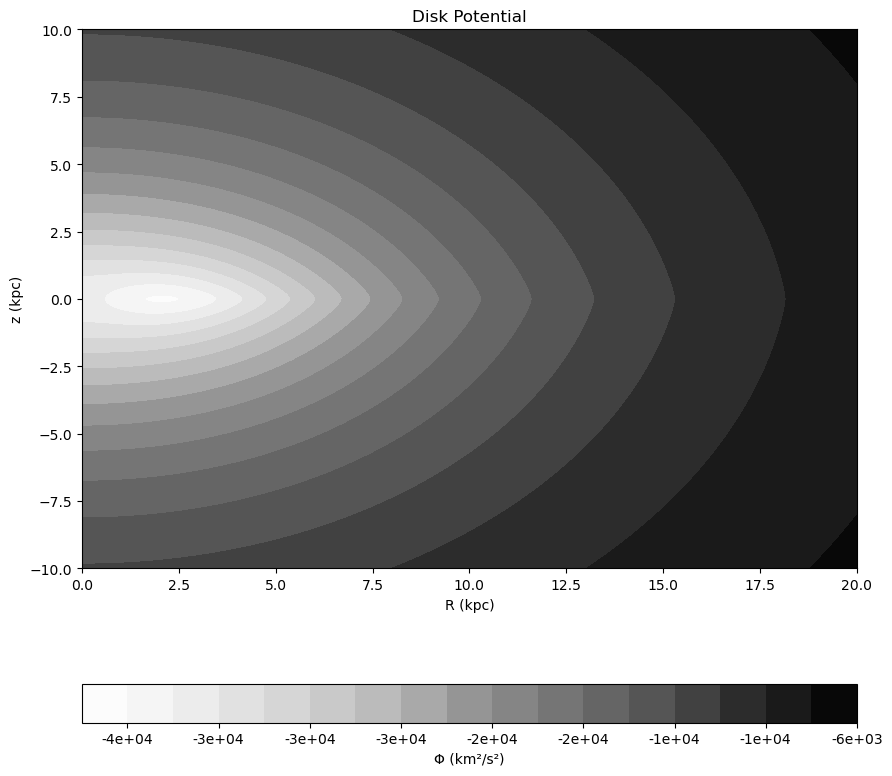

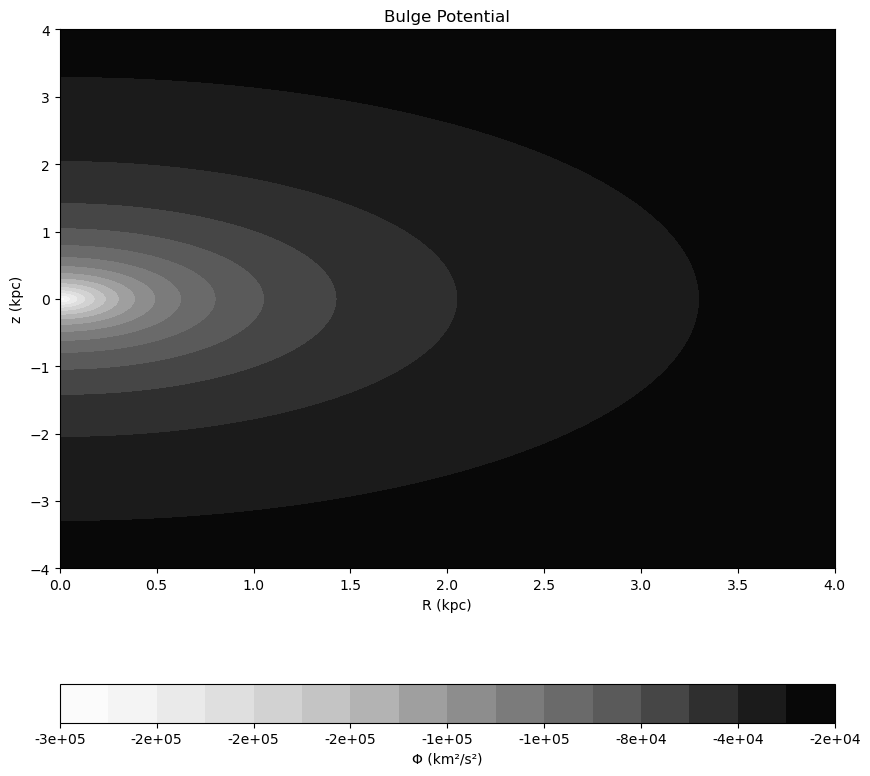

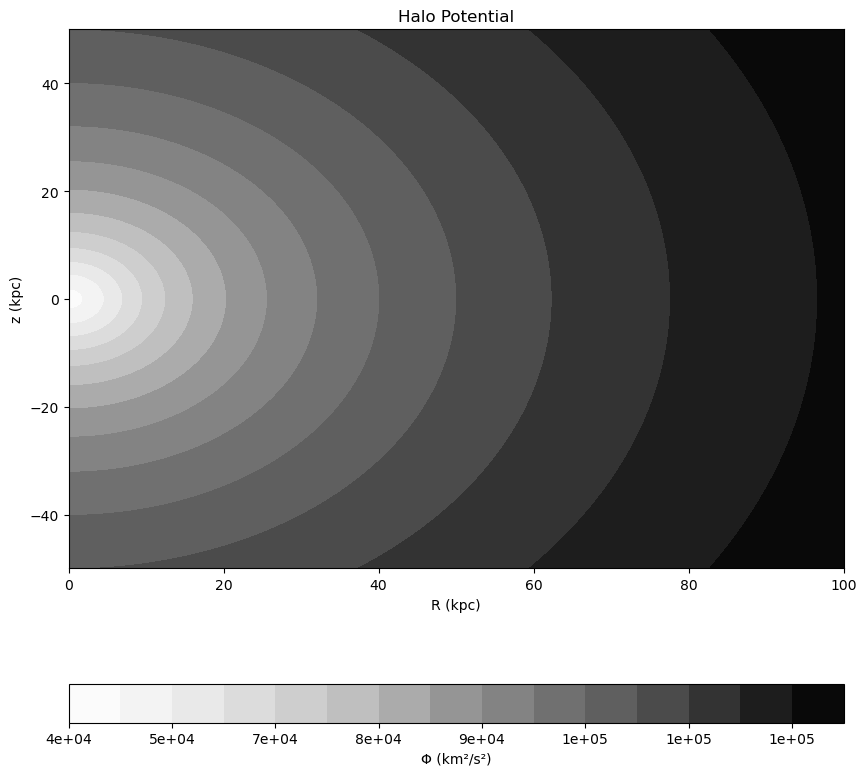

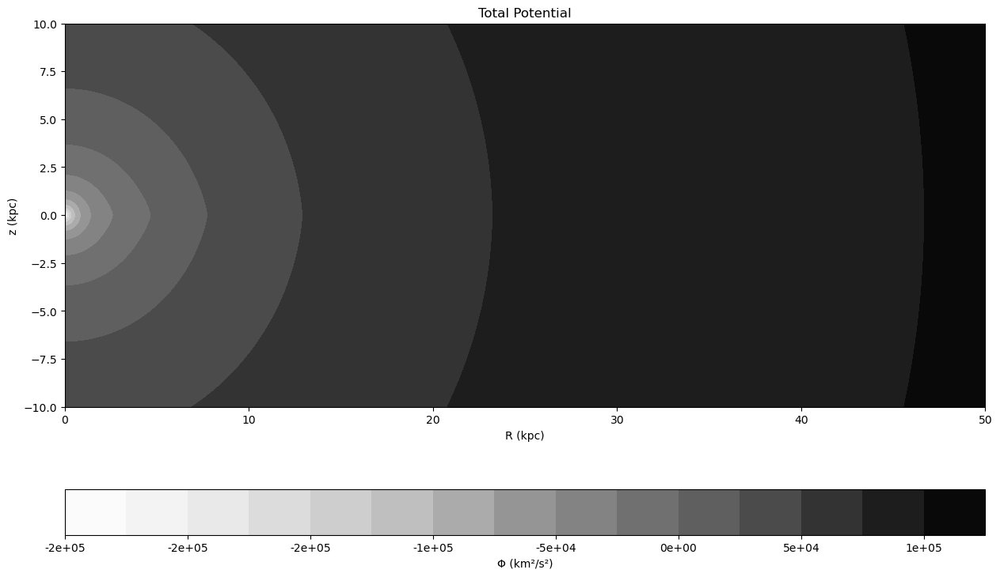

In [5]:
# Contour Plot of Gravitational Potential 

# Disk Potential
x = np.linspace(0, 20, 1000) * u.kpc
y = 0
z = np.linspace(-10, 10, 1000) * u.kpc

X, Z = np.meshgrid(x, z)
disk = pot_disk(X, y, Z)
fig, ax = plt.subplots(1, 1, figsize = (10,10))
cp = ax.contourf(X, Z, disk, 15, cmap = 'Greys')
fig.colorbar(cp, label = 'Φ (km²/s²)', orientation = 'horizontal', format = '%.0e') # Add a colorbar to a plot
ax.set_title('Disk Potential')
ax.set_xlabel('R (kpc)')
ax.set_ylabel('z (kpc)')
plt.show()


# Bulge Potential
x = np.linspace(0, 4, 1000) * u.kpc
y = 0
z = np.linspace(-4, 4, 1000) * u.kpc

X, Z = np.meshgrid(x, z)
bulge = pot_bulge(X, y, Z)
fig, ax = plt.subplots(1, 1, figsize = (10,10))
cp = ax.contourf(X, Z, bulge, 15, cmap = 'Greys')
fig.colorbar(cp, label='Φ (km²/s²)', orientation = 'horizontal', format = '%.0e') # Add a colorbar to a plot
ax.set_title('Bulge Potential')
ax.set_xlabel('R (kpc)')
ax.set_ylabel('z (kpc)')
plt.show()


# Halo Potential
x = np.linspace(0, 100, 1000) * u.kpc
y = 0
z = np.linspace(-50, 50, 1000) * u.kpc

X, Z = np.meshgrid(x, z)
halo = pot_halo(X, y, Z)
fig, ax = plt.subplots(1, 1, figsize = (10,10))
cp = ax.contourf(X, Z, halo, 15, cmap = 'Greys')
fig.colorbar(cp, label = 'Φ (km²/s²)', orientation = 'horizontal', format='%.0e') # Add a colorbar to a plot
ax.set_title('Halo Potential')
ax.set_xlabel('R (kpc)')
ax.set_ylabel('z (kpc)')
plt.show()


# Total Potential
x = np.linspace(0, 50, 1000) * u.kpc
y = 0
z = np.linspace(-10, 10, 1000) * u.kpc

X, Z = np.meshgrid(x, z)
total = totpot(X, y, Z)
fig, ax = plt.subplots(1, 1, figsize = (15,9))
cp = ax.contourf(X, Z, total, 15, cmap = 'Greys')
fig.colorbar(cp, label = 'Φ (km²/s²)', orientation = 'horizontal', format = '%.0e') # Add a colorbar to a plot
ax.set_title('Total Potential')
ax.set_xlabel('R (kpc)')
ax.set_ylabel('z (kpc)')
plt.show()

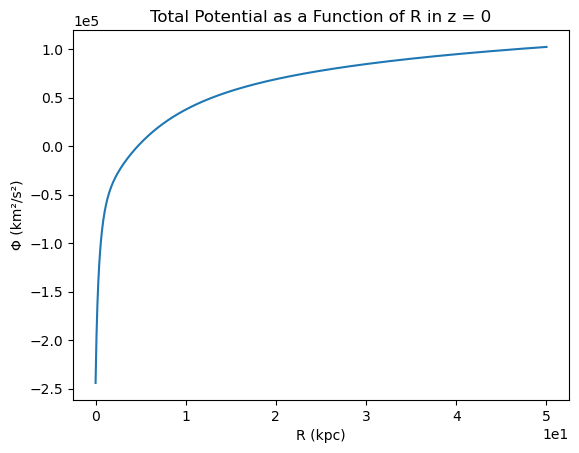

In [6]:
#Total Potential as Function of R in z = 0
x = np.linspace(0, 50, 1000) * u.kpc
y = 0 * u.kpc
z = 0 * u.kpc 

plt.plot(x, totpot(x, y, z))
plt.title('Total Potential as a Function of R in z = 0')
plt.xlabel('R (kpc)')
plt.ylabel('Φ (km²/s²)')
plt.ticklabel_format(axis='both', style='sci', scilimits=(0,0))
plt.show()

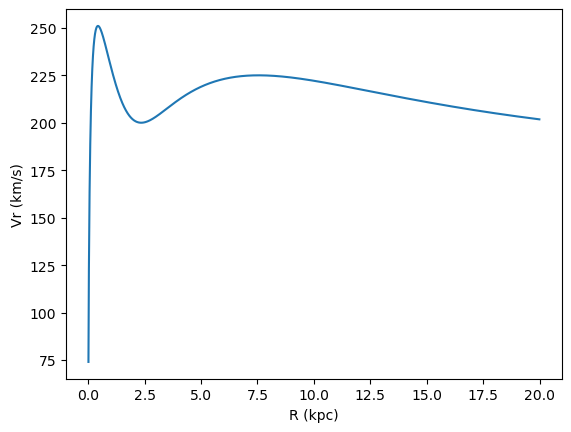

Wall time: 2min 50s


In [7]:
%%time
# Rotation curve plotting from Eq. (24) (Barros, et al. 2016)

x = 0.01 * u.kpc
y = 0 * u.kpc
z = 0 * u.kpc
dx = 0.01 * u.kpc
Vrot = []
RADIUS = []

while x.value < 20:
    dpot = ((((totpot(x + dx/2, y, z)) - (totpot(x - dx/2, y, z))) / dx) + ((totpot(x + dx/2, y, z) - 2*totpot(x, y, z) + totpot(x - dx/2, y, z))/ dx)).decompose()
    Vc = np.sqrt(x * dpot)
    Vc = Vc.to(u.km / u.s) 
    Vrot.append(Vc.value)
    RADIUS.append(x.value)
    x += dx
    #print(x)

plt.plot(RADIUS, Vrot)
plt.xlabel('R (kpc)')
plt.ylabel('Vr (km/s)')
plt.show()

# Stellar Data

In [8]:
import astropy.units as u

# The data used is obtained from Gaia Archive
data = pd.read_csv('GAIA_Data.csv', on_bad_lines='skip')
for i in data.columns:
    print(i)

Unnamed: 0.1
Unnamed: 0
solution_id
designation
source_id
random_index
ref_epoch
ra
ra_error
dec
dec_error
parallax
parallax_error
parallax_over_error
pm
pmra
pmra_error
pmdec
pmdec_error
ra_dec_corr
ra_parallax_corr
ra_pmra_corr
ra_pmdec_corr
dec_parallax_corr
dec_pmra_corr
dec_pmdec_corr
parallax_pmra_corr
parallax_pmdec_corr
pmra_pmdec_corr
astrometric_n_obs_al
astrometric_n_obs_ac
astrometric_n_good_obs_al
astrometric_n_bad_obs_al
astrometric_gof_al
astrometric_chi2_al
astrometric_excess_noise
astrometric_excess_noise_sig
astrometric_params_solved
astrometric_primary_flag
nu_eff_used_in_astrometry
pseudocolour
pseudocolour_error
ra_pseudocolour_corr
dec_pseudocolour_corr
parallax_pseudocolour_corr
pmra_pseudocolour_corr
pmdec_pseudocolour_corr
astrometric_matched_transits
visibility_periods_used
astrometric_sigma5d_max
matched_transits
new_matched_transits
matched_transits_removed
ipd_gof_harmonic_amplitude
ipd_gof_harmonic_phase
ipd_frac_multi_peak
ipd_frac_odd_win
ruwe
scan_direc

In [9]:
# Select only the columns needed
data = data[['source_id', 'ra', 'dec', 'parallax', 'parallax_over_error',
             'pmra', 'pmra_error', 'pmdec', 'pmdec_error', 'radial_velocity', 'radial_velocity_error']]

# Do some pre-processing
data = data.dropna()
data = data.sort_values(by=['parallax_over_error'], ascending = False).reset_index()
data = data.loc[data['parallax'] > 0]
data

,index,source_id,ra,dec,parallax,parallax_over_error,pmra,pmra_error,pmdec,pmdec_error,radial_velocity,radial_velocity_error
0,465436,201140400878588544,78.072326,41.443888,33.976671,1859.032000,-14.242632,0.024172,-472.469377,0.017614,-36.570427,0.134591
1,233106,200481484174482048,75.602695,39.174144,24.121029,1527.360700,-62.168062,0.020405,-202.014527,0.015412,-36.359660,0.196414
2,177115,200296663143599104,73.151092,40.701839,74.069846,1517.448500,1175.720001,0.055516,-1095.405742,0.042593,102.451546,0.289745
3,457916,201121430002241920,78.096123,41.326993,25.214571,1491.714000,51.935166,0.020036,-127.994881,0.014832,5.025700,0.231829
4,180637,200307211581403776,73.544288,40.784916,21.332687,1199.590700,-75.034631,0.022283,-49.329868,0.016129,-30.626040,0.305142
...,...,...,...,...,...,...,...,...,...,...,...,...
16977,513364,4058798005150564608,263.272668,-29.053480,0.000007,0.000085,-3.212768,0.082091,-4.930522,0.054967,99.307080,3.980480
16978,513402,4064005360944028544,270.284000,-26.345724,0.000008,0.000078,-5.857345,0.122159,-8.689686,0.081379,-21.549358,4.558952
16979,513327,4058601742331371008,262.387990,-30.350116,0.000005,0.000063,-3.008806,0.079397,-4.278527,0.059025,91.235245,6.241204
16980,513318,4067889424421226112,266.044676,-25.566712,0.000004,0.000060,-3.870593,0.082972,-4.975802,0.050324,-224.213940,3.587962


In [10]:
# We use astropy.coordinates to get the galactocentric coordinates and velocity

galactocent = coord.SkyCoord(ra = data['ra'] * u.degree,
                   dec = data['dec'] * u.degree,
                   distance = 1/data['parallax'] * u.kpc,
                   pm_ra_cosdec = data['pmra']*u.mas/u.yr,
                   pm_dec = data['pmdec']*u.mas/u.yr,
                   radial_velocity = data['radial_velocity']*u.km/u.s,
                   frame='icrs')

galactocent = galactocent.transform_to(coord.Galactocentric)

x = galactocent.x.value
y = galactocent.y.value
z = galactocent.z.value
U = galactocent.v_x.value
V = galactocent.v_y.value
W = galactocent.v_z.value

data['x'] = x
data['y'] = y
data['z'] = z
data['U'] = U
data['V'] = V
data['W'] = W
data

,index,source_id,ra,dec,parallax,parallax_over_error,pmra,pmra_error,pmdec,pmdec_error,radial_velocity,radial_velocity_error,x,y,z,U,V,W
0,465436,201140400878588544,78.072326,41.443888,33.976671,1859.032000,-14.242632,0.024172,-472.469377,0.017614,-36.570427,0.134591,-8.150501,0.007203,0.021524,34.622447,1.863490e+02,-3.350185e+01
1,233106,200481484174482048,75.602695,39.174144,24.121029,1527.360700,-62.168062,0.020405,-202.014527,0.015412,-36.359660,0.196414,-8.162275,0.009663,0.019745,43.495741,2.136091e+02,-2.520490e+01
2,177115,200296663143599104,73.151092,40.701839,74.069846,1517.448500,1175.720001,0.055516,-1095.405742,0.042593,102.451546,0.289745,-8.134953,0.003685,0.020333,-113.889843,1.756613e+02,1.807818e+01
3,457916,201121430002241920,78.096123,41.326993,25.214571,1491.714000,51.935166,0.020036,-127.994881,0.014832,5.025700,0.231829,-8.160433,0.009635,0.021738,1.757829,2.224088e+02,1.641846e+00
4,180637,200307211581403776,73.544288,40.784916,21.332687,1199.590700,-75.034631,0.022283,-49.329868,0.016129,-30.626040,0.305142,-8.167075,0.012699,0.019412,43.470409,2.390530e+02,-1.116001e+01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16977,513364,4058798005150564608,263.272668,-29.053480,0.000007,0.000085,-3.212768,0.082091,-4.930522,0.054967,99.307080,3.980480,148649.701968,-4044.077043,5478.997064,-113160.552840,-4.149677e+06,1.028197e+04
16978,513402,4064005360944028544,270.284000,-26.345724,0.000008,0.000078,-5.857345,0.122159,-8.689686,0.081379,-21.549358,4.558952,122861.922306,8541.440843,-3852.682416,437676.928893,-6.088327e+06,4.602749e+05
16979,513327,4058601742331371008,262.387990,-30.350116,0.000005,0.000063,-3.008806,0.079397,-4.278527,0.059025,91.235245,6.241204,209802.196941,-11234.451853,7495.850116,-283945.181866,-5.202858e+06,1.524260e+05
16980,513318,4067889424421226112,266.044676,-25.566712,0.000004,0.000060,-3.870593,0.082972,-4.975802,0.050324,-224.213940,3.587962,234009.143786,11064.447798,7713.274394,303105.380528,-6.955112e+06,7.747464e+05


In [11]:
# Function to derive error of U, W, W
# From Eq. (2) (Johnson & Soderblom, 1987)
# ra & dec in degree, parallax in mas, rho in km/s, pmra & pmdec in mas/yr 
# This is also quite messy, I believe there's a library to do matrix multiplication better 
# But this works for now

def galactocent_err(ra, dec, parallax, rho, pmra, pmdec, dparallax, drho, dpmra, dpmdec):
    k = 4.74057
    koef = 2*pmra*pmdec*k**2 * dparallax**2 / parallax**4
    # Program to multiply two matrices using nested loops
    # 3x3 matrix
    T = [[-0.06699,-0.87276,-0.48354],
        [ 0.49273,-0.45035,0.74458],
        [-0.86760,-0.18837,0.46020]]
    # 3x3 matrix
    A = [[np.cos(ra) * np.cos(dec),-np.sin(ra),-np.cos(ra) * np.sin(dec)],
        [np.sin(ra) * np.cos(dec),np.cos(ra),-np.sin(ra) * np.sin(dec)],
        [np.sin(dec),0,np.cos(dec)]]
    # result is 3x3
    C = [[0,0,0],
        [0,0,0],
        [0,0,0]]

    # iterate through rows of T
    for i in range(len(T)):
        # iterate through columns of A
        for j in range(len(A[0])):
            # iterate through rows of A
            for k in range(len(A)):
                C[i][j] += (T[i][k] * A[k][j])**2
    
    E = [[drho**2],
        [(k/parallax)**2 * (dpmra**2 + (pmra*dparallax/parallax)**2)],
        [(k/parallax)**2 * (dpmdec**2 + (pmdec*dparallax/parallax)**2)]]
    
    result = [[0],
             [0],
             [0]]
    
    # iterate through rows of C
    for i in range(len(C)):
        # iterate through columns of E
        for j in range(len(E[0])):
            # iterate through rows of E
            for k in range(len(E)):
                result[i][j] += C[i][k] * E[k][j]
    
    dU = result[0][0] + koef*np.sqrt(C[0][1]*C[0][2])
    dV = result[1][0] + koef*np.sqrt(C[1][1]*C[1][2])
    dW = result[2][0] + koef*np.sqrt(C[2][1]*C[2][2])
    
    return np.sqrt(abs(dU)), np.sqrt(abs(dV)), np.sqrt(abs(dW))


# Assign the error of U, V, W into the dataframe

dU = []
dV = []
dW = []

for i in range(len(data)):
    du, dv, dw = galactocent_err(data['ra'][i] * np.pi/180, data['dec'][i] * np.pi/180, data['parallax'][i], data['radial_velocity'][i], data['pmra'][i]*np.cos(data['dec'][i] * np.pi/180), data['pmdec'][i], data['parallax'][i]/data['parallax_over_error'][i], data['radial_velocity_error'][i], data['pmra_error'][i], data['pmdec_error'][i])
    dU.append(du)
    dV.append(dv)
    dW.append(dw)

data['dU'] = dU
data['dV'] = dV
data['dW'] = dW
data

,index,source_id,ra,dec,parallax,parallax_over_error,pmra,pmra_error,pmdec,pmdec_error,...,radial_velocity_error,x,y,z,U,V,W,dU,dV,dW
0,465436,201140400878588544,78.072326,41.443888,33.976671,1859.032000,-14.242632,0.024172,-472.469377,0.017614,...,0.134591,-8.150501,0.007203,0.021524,34.622447,1.863490e+02,-3.350185e+01,9.689368e-02,8.117806e-02,4.906256e-02
1,233106,200481484174482048,75.602695,39.174144,24.121029,1527.360700,-62.168062,0.020405,-202.014527,0.015412,...,0.196414,-8.162275,0.009663,0.019745,43.495741,2.136091e+02,-2.520490e+01,1.423868e-01,1.159674e-01,7.242502e-02
2,177115,200296663143599104,73.151092,40.701839,74.069846,1517.448500,1175.720001,0.055516,-1095.405742,0.042593,...,0.289745,-8.134953,0.003685,0.020333,-113.889843,1.756613e+02,1.807818e+01,2.040029e-01,1.699213e-01,1.060815e-01
3,457916,201121430002241920,78.096123,41.326993,25.214571,1491.714000,51.935166,0.020036,-127.994881,0.014832,...,0.231829,-8.160433,0.009635,0.021738,1.757829,2.224088e+02,1.641846e+00,1.661047e-01,1.384311e-01,8.321027e-02
4,180637,200307211581403776,73.544288,40.784916,21.332687,1199.590700,-75.034631,0.022283,-49.329868,0.016129,...,0.305142,-8.167075,0.012699,0.019412,43.470409,2.390530e+02,-1.116001e+01,2.162131e-01,1.819258e-01,1.160373e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16977,513364,4058798005150564608,263.272668,-29.053480,0.000007,0.000085,-3.212768,0.082091,-4.930522,0.054967,...,3.980480,148649.701968,-4044.077043,5478.997064,-113160.552840,-4.149677e+06,1.028197e+04,1.561627e+10,2.829741e+10,2.825271e+10
16978,513402,4064005360944028544,270.284000,-26.345724,0.000008,0.000078,-5.857345,0.122159,-8.689686,0.081379,...,4.558952,122861.922306,8541.440843,-3852.682416,437676.928893,-6.088327e+06,4.602749e+05,2.121266e+10,4.649784e+10,4.670901e+10
16979,513327,4058601742331371008,262.387990,-30.350116,0.000005,0.000063,-3.008806,0.079397,-4.278527,0.059025,...,6.241204,209802.196941,-11234.451853,7495.850116,-283945.181866,-5.202858e+06,1.524260e+05,2.727896e+10,4.791038e+10,4.807799e+10
16980,513318,4067889424421226112,266.044676,-25.566712,0.000004,0.000060,-3.870593,0.082972,-4.975802,0.050324,...,3.587962,234009.143786,11064.447798,7713.274394,303105.380528,-6.955112e+06,7.747464e+05,3.367926e+10,7.119955e+10,7.244131e+10


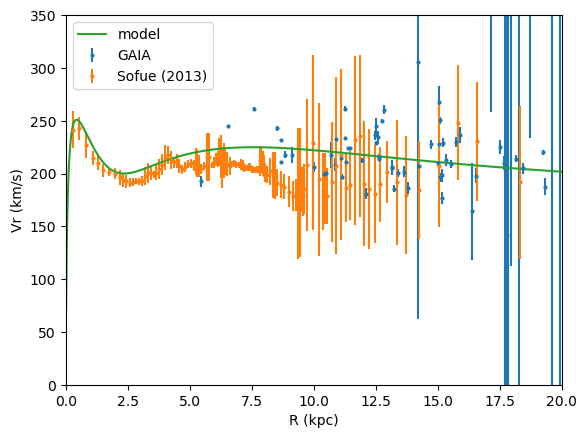

In [23]:
# Rotation Curve Fitting
# WARNING
# Messy code ahead
# Please tell me if you know better way to sample the data

# We sample the data from Gaia into 5 range of R
random = 123456
dat1 = data.loc[data['x'] < 10].sample(n = 10, random_state = random)
dat2 = data.loc[(abs(data['x']) < 12.5) & (abs(data['x']) > 10)].sample(n = 15, random_state = random)
dat3 = data.loc[(abs(data['x']) < 15) & (abs(data['x']) > 12.5)].sample(n = 15, random_state = random)
dat4 = data.loc[(abs(data['x']) < 17.5) & (abs(data['x']) > 15)].sample(n = 15, random_state = random)
dat5 = data.loc[(abs(data['x']) < 20) & (abs(data['x']) > 17.5)].sample(n = 15, random_state = random)

radius = []
Vx = []
Vy = []
Vz = []
errx = []
erry = []
errz = []

radius.extend(((dat1['x']), (dat2['x']), (dat3['x']), (dat4['x']), (dat5['x'])))
Vx.extend(((dat1['U']), (dat2['U']), (dat3['U']), (dat4['U']), (dat5['U'])))
Vy.extend(((dat1['V']), (dat2['V']), (dat3['V']), (dat4['V']), (dat5['V'])))
Vz.extend(((dat1['W']), (dat2['W']), (dat3['W']), (dat4['W']), (dat5['W'])))
errx.extend(((dat1['dU']), (dat2['dU']), (dat3['dU']), (dat4['dU']), (dat5['dU'])))
erry.extend(((dat1['dV']), (dat2['dV']), (dat3['dV']), (dat4['dV']), (dat5['dV'])))
errz.extend(((dat1['dW']), (dat2['dW']), (dat3['dW']), (dat4['dW']), (dat5['dW'])))

r = []
vx = []
vy = []
vz = []
Errx = []
Erry = []
Errz = []

def flat(x, y):
    for i in x: 
        for j in i:
            y.append(j)

flat(radius, r)
flat(Vx, vx)
flat(Vy, vy)
flat(Vz, vz)
flat(errx, Errx)
flat(erry, Erry)
flat(errz, Errz)
    
Velocity = []
Error_bar = []

for i in range(len(vx)):
    Velocity.append(np.sqrt((vx[i])**2 + (vy[i])**2 + (vz[i])**2))
    Error_bar.append(np.sqrt(Errx[i]**2 + Erry[i]**2 + Errz[i]**2))

    
# We also use data from Sofue (2013)
# sc: https://arxiv.org/pdf/1110.4431.pdf

r_ = np.loadtxt('sofue.txt', usecols=0)
v_ = np.loadtxt('sofue.txt', usecols=1)
err_ = np.loadtxt('sofue.txt', usecols=2)

plt.errorbar(abs(np.array(r)), abs(np.array(Velocity)),  fmt = 'o', yerr = Error_bar, markersize=2, label='GAIA')
plt.errorbar(r_, v_,  fmt = 'o', yerr = err_, markersize=2, label='Sofue (2013)')
plt.plot(RADIUS, Vrot, label='model')
plt.xlabel('R (kpc)')
plt.ylabel('Vr (km/s)')
plt.xlim(0,20)
plt.ylim(0, 350)
plt.legend()
plt.show()

# Orbit Simulation

In [5]:
# We use Sun's data for disk component star
x = -8.122 * u.kpc
y = 0 * u.kpc
z = 0.0208 * u.kpc
U = 12.9 * u.kilometer / (u.second)
V = 245.6 * u.kilometer / (u.second)
W = 7.78 * u.kilometer / (u.second)
Ax = 0 * u.kilometer / (u.s)**2
Ay = 0 * u.kilometer / (u.s)**2
Az = 0 * u.kilometer / (u.s)**2
X, Y, Z = [x.value], [y.value], [z.value]
R = [np.sqrt(x.value**2 + y.value**2)]

dt = 2.5E4 * u.yr                                            # Timestep of the simulation
t = 0 * u.yr                                                 # Set t0 = 0

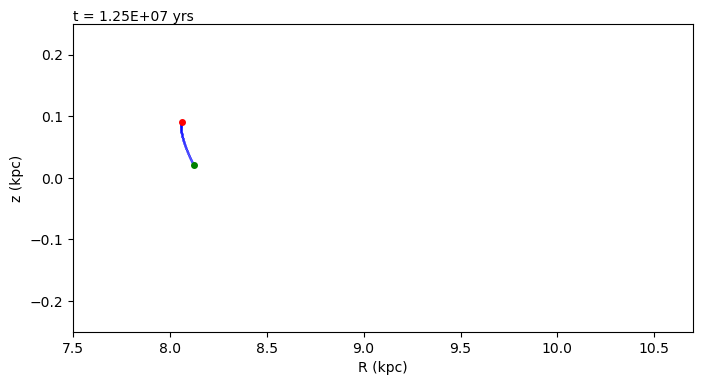

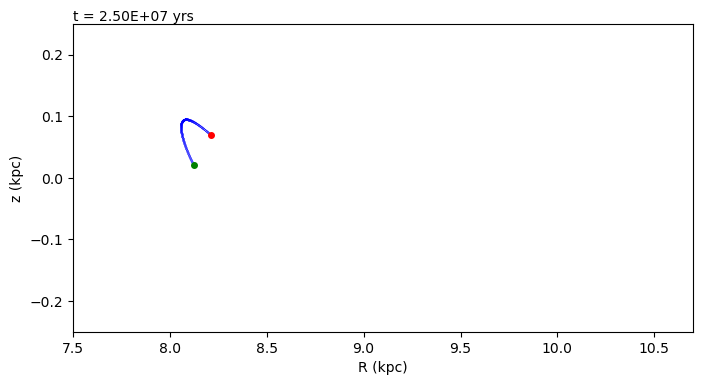

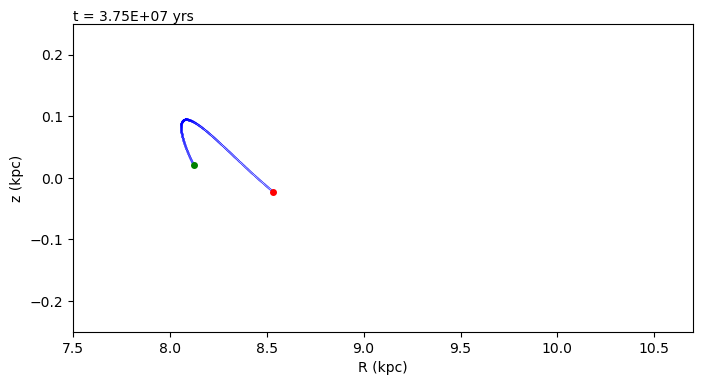

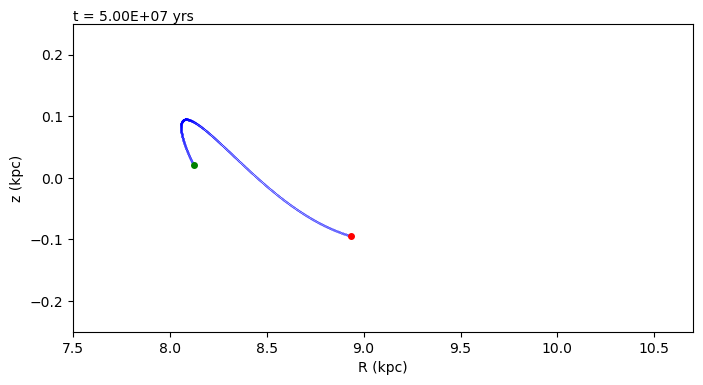

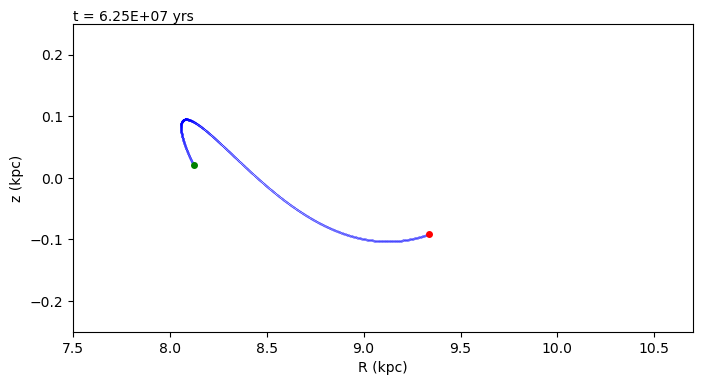

...

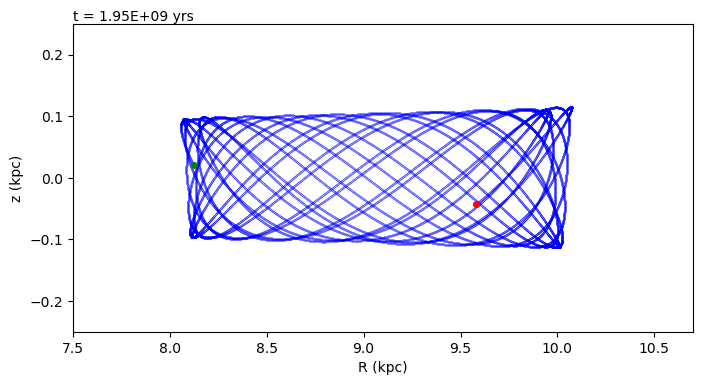

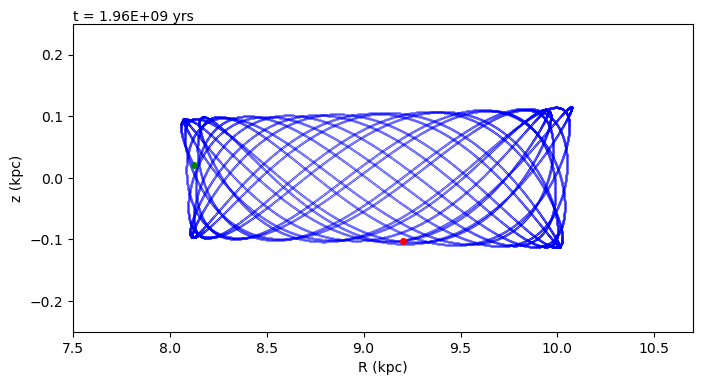

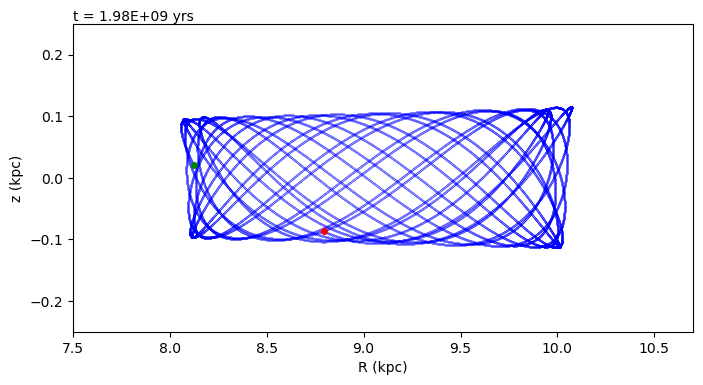

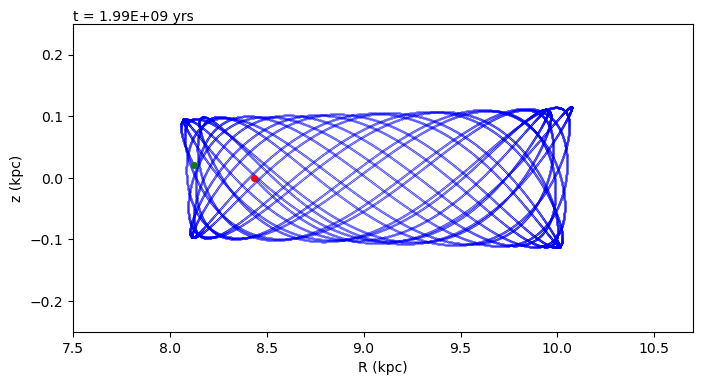

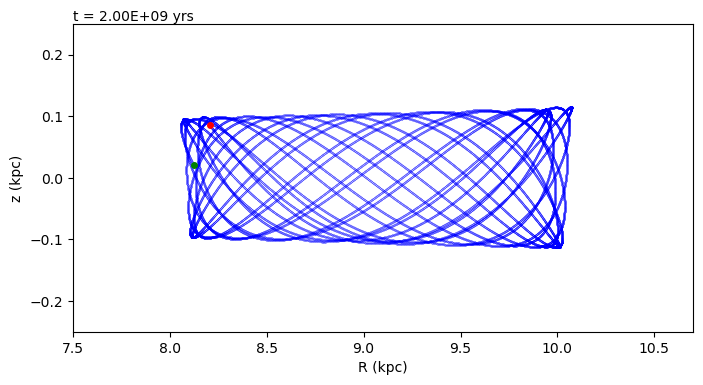

Wall time: 4h 58min 30s


In [6]:
%%time
# The simulation uses second order approximation of gradient
# This implies the simulation will result large error for large dt 
# Result also may deviates at large enough t
# Another note: at dt constant, typically error increase as U, V, W increase
#               choose smaller dt for larger U, V, W

# WARNING
# Long simulation ahead, this'll take quite some time

count = 0
while t.value <= 2E9:                                        # We do the simulation for 2 Gyr
    dx = (U*dt).decompose() + (0.5*Ax*dt**2).decompose()
    dy = (V*dt).decompose() + (0.5*Ay*dt**2).decompose()
    dz = (W*dt).decompose() + (0.5*Az*dt**2).decompose()
    Ax = -((((totpot(x + dx/2, y, z)) - (totpot(x - dx/2, y, z))) / dx) + ((totpot(x + dx/2, y, z) - 2*totpot(x, y, z) + totpot(x - dx/2, y, z))/ dx)).decompose()
    Ay = -((((totpot(x, y + dy/2, z)) - (totpot(x, y - dy/2, z))) / dy) + ((totpot(x, y + dy/2, z) - 2*totpot(x, y, z) + totpot(x, y - dy/2, z))/ dy)).decompose()
    Az = -((((totpot(x, y, z + dz/2)) - (totpot(x, y, z - dz/2))) / dz) + ((totpot(x, y, z + dz/2) - 2*totpot(x, y, z) + totpot(x, y, z - dz/2))/ dz)).decompose()
    U += (Ax*dt).decompose()
    V += (Ay*dt).decompose()
    W += (Az*dt).decompose()
    x += dx.decompose()
    y += dy.decompose()
    z += dz.decompose()
    X.append(x.value)
    Y.append(y.value)
    Z.append(z.value)
    R.append(np.sqrt(x.value**2 + y.value**2))
    t += dt
    count += 1

    if count%500 == 0:                                        # Plotting frequency
        fig, ax = plt.subplots(figsize=(8, 4))
        plt.plot(R, Z, 'bo', markersize=.1, alpha=.5)
        plt.plot(np.sqrt(x.value**2 + y.value**2), z.value, 'ro', markersize=4)
        plt.plot(R[0], Z[0], 'go', markersize=4)
        plt.text(7.5, 0.255, 't = ' + str('%.2E' % Decimal(t.value)) + ' yrs')
        plt.xlim(7.5, 10.7)
        plt.ylim(-0.25, 0.25)
        plt.xlabel('R (kpc)')
        plt.ylabel('z (kpc)')
        plt.show()

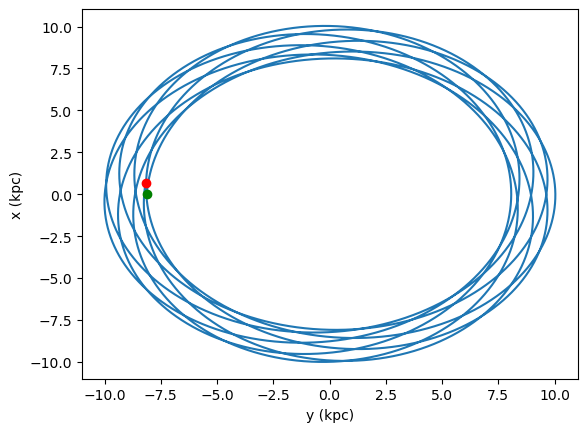

In [7]:
# Plotting on XY plane
plt.plot(X, Y)
plt.plot(X[0], Y[0], 'go')
plt.plot(X[len(X) - 1], Y[len(Y) - 1], 'ro')
plt.xlabel('y (kpc)')
plt.ylabel('x (kpc)')
plt.show()

In [13]:
# For halo component star, we define a star with z > 0.5 kpc is a halo component star
halo_star = data.loc[data['z'] > 0.5]
halo_star

,index,source_id,ra,dec,parallax,parallax_over_error,pmra,pmra_error,pmdec,pmdec_error,...,radial_velocity_error,x,y,z,U,V,W,dU,dV,dW
8735,515859,4011248495230896512,189.955684,29.904232,0.232143,15.984647,1.873303,0.015745,-13.085280,0.013904,...,2.227375,-8.384351,0.074092,4.319861,191.900553,3.603026e+01,-9.332436e+01,3.927208e+00,1.957232e+00,3.214326e+00
9428,515773,4011186647701868032,190.507456,29.708662,0.240664,13.262324,-7.484842,0.017464,-11.836441,0.016989,...,3.606983,-8.338120,0.077651,4.169613,13.021148,-3.113912e+01,-3.767524e+01,1.217580e+01,1.182418e+01,8.694482e+00
9723,516995,4012094363269673984,186.618838,30.671275,0.236824,12.289471,-3.328490,0.020731,-0.759690,0.024245,...,1.980593,-8.589791,0.012618,4.217336,-36.097424,1.991628e+02,-5.434038e+00,2.734037e+00,2.406365e+00,2.026629e+00
9801,515565,4011032647354367360,189.969719,28.994798,0.195952,12.031735,-7.124288,0.015999,-1.708514,0.014938,...,1.170127,-8.389578,0.019341,5.117045,-110.628661,1.200261e+02,-2.707797e+01,7.281519e+00,5.841538e+00,3.874292e+00
9805,515782,4011191836022364800,190.480438,29.874007,0.198122,12.020865,-4.132253,0.015430,-7.649635,0.016764,...,2.671911,-8.393945,0.105608,5.059744,23.852958,3.850629e+01,3.730332e+01,9.726232e+00,9.569702e+00,7.049415e+00
9936,515234,4010798898054421376,188.072605,28.681895,0.201291,11.642772,-3.461124,0.016108,-13.463602,0.017085,...,2.859358,-8.491552,-0.078861,4.974341,108.011753,-6.794650e+01,-3.659159e+01,1.241382e+01,1.313362e+01,9.611674e+00
10095,515339,4010868064207684608,187.490878,29.046702,0.198574,11.196829,-3.160428,0.014224,1.328908,0.016260,...,1.625767,-8.551295,-0.075050,5.037801,-67.670995,2.348792e+02,-2.271512e+00,2.694973e+00,2.765163e+00,1.347072e+00
10299,515346,4010874833076166400,187.613047,29.158754,0.246368,10.566654,6.631004,0.023969,-9.611322,0.022936,...,9.073120,-8.465525,-0.049819,4.064897,223.429681,1.518367e+02,-6.430067e+01,1.029277e+01,7.689483e+00,4.791577e+00
10915,515637,4011084015163240576,190.323420,29.530108,0.132869,8.887421,-0.190707,0.015017,-12.112737,0.014237,...,1.694325,-8.518999,0.109646,7.535706,240.976314,-1.273650e+02,-1.084446e+02,1.008148e+01,1.491774e+01,1.236717e+01
10940,515608,4011063674198132864,190.362193,29.227468,0.189686,8.814957,-21.153727,0.019346,-3.708891,0.019863,...,5.787577,-8.382814,0.054765,5.285933,-393.786129,-1.101802e+02,1.195256e+02,2.778849e+01,2.154138e+01,1.448858e+01


In [16]:
x = halo_star['x'].iloc[0] * u.kpc
y = halo_star['y'].iloc[0] * u.kpc
z = halo_star['z'].iloc[0] * u.kpc
U = halo_star['U'].iloc[0] * u.kilometer / (u.second)
V = halo_star['V'].iloc[0] * u.kilometer / (u.second)
W = halo_star['W'].iloc[0] * u.kilometer / (u.second)
Ax = 0 * u.kilometer / (u.s)**2
Ay = 0 * u.kilometer / (u.s)**2
Az = 0 * u.kilometer / (u.s)**2
X, Y, Z = [x.value], [y.value], [z.value]
R = [np.sqrt(x.value**2 + y.value**2)]
             
dt = 1E4 * u.yr                                            # Timestep of the simulation
t = 0 * u.yr                                               # Set t0 = 0

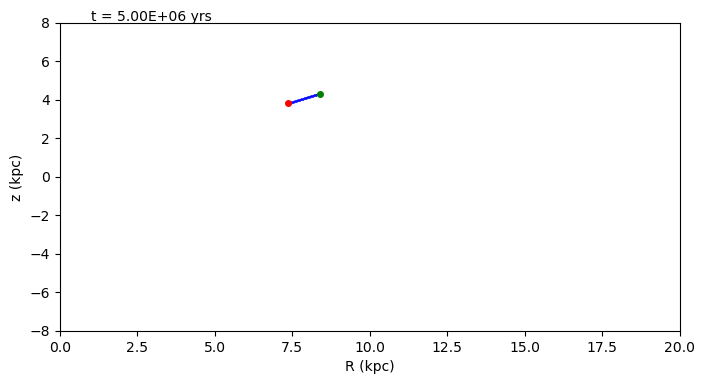

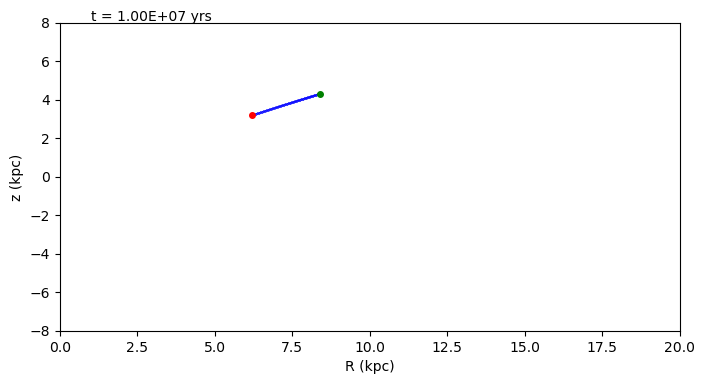

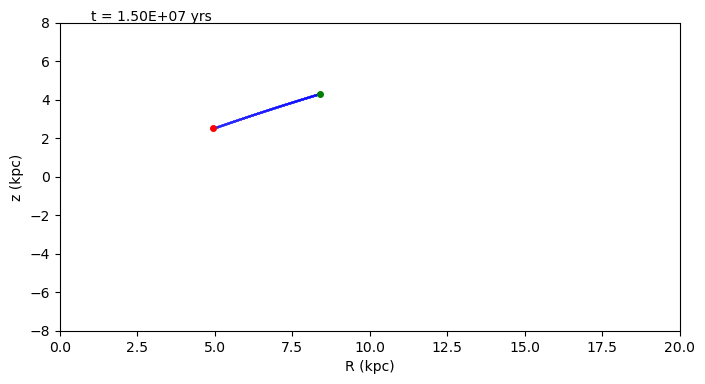

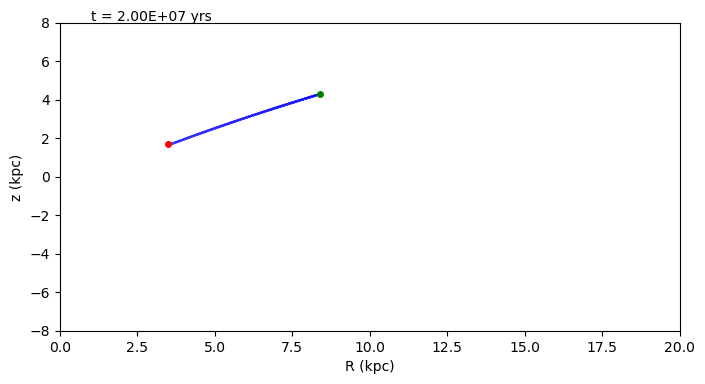

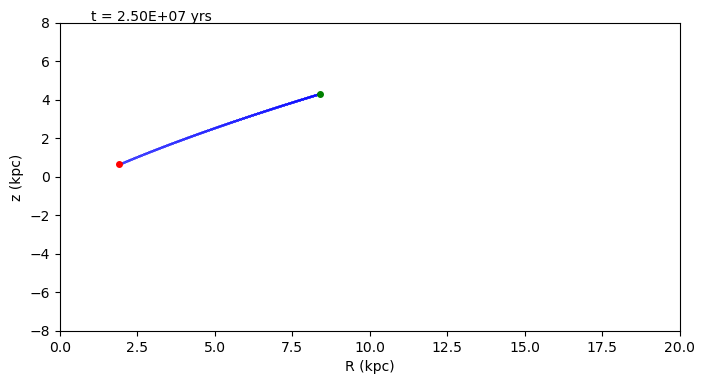

...

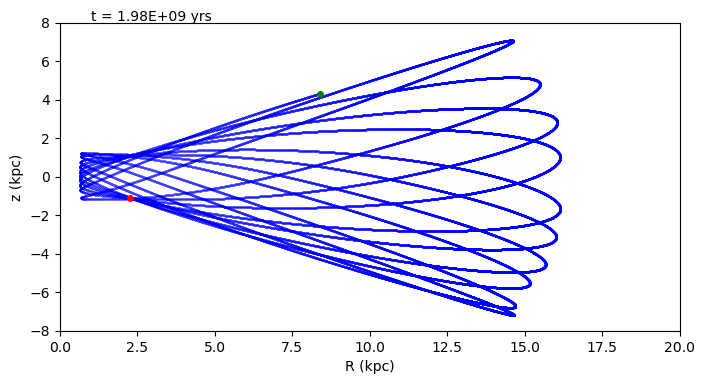

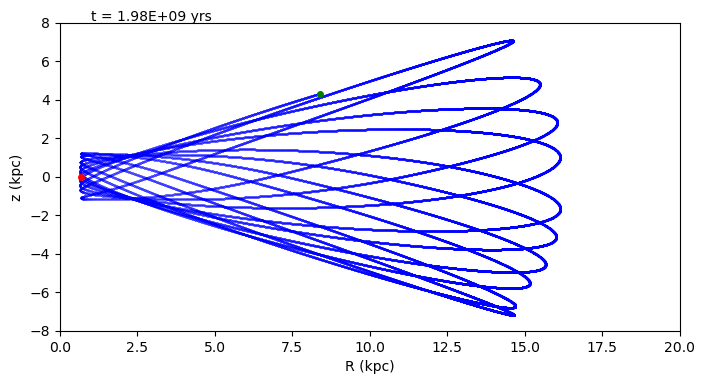

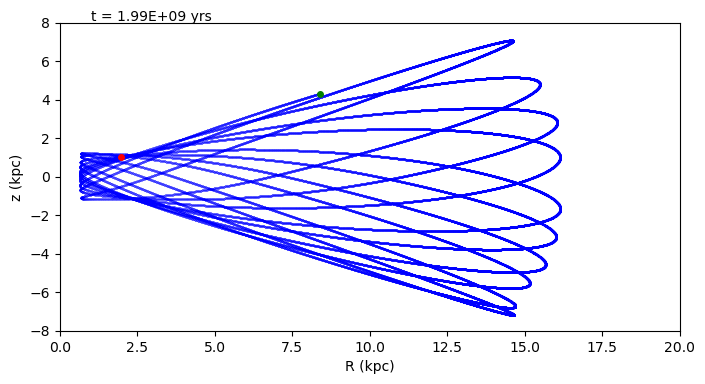

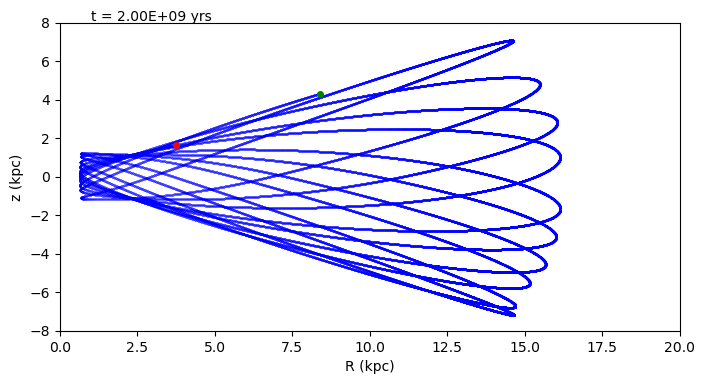

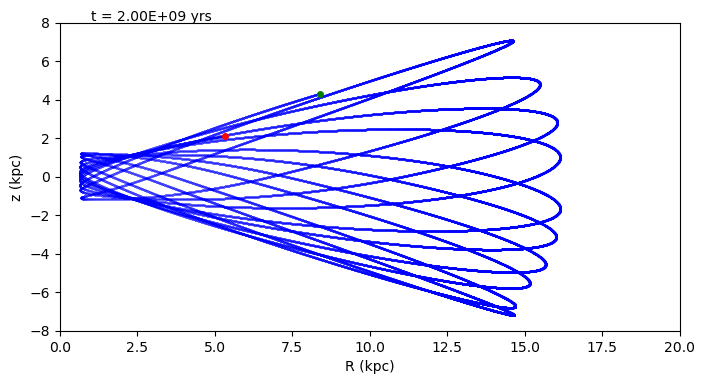

Wall time: 13h 26min 46s


In [17]:
%%time
# The simulation uses second order approximation of gradient
# This implies the simulation will result large error for large dt 
# Result also may deviates at large enough t
# Another note: at dt constant, typically error increase as U, V, W increase
#               choose smaller dt for larger U, V, W

# WARNING
# Long simulation ahead, this'll take quite some time

count = 0
while t.value <= 2E9:                                        # We do the simulation for 2 Gyr
    dx = (U*dt).decompose() + (0.5*Ax*dt**2).decompose()
    dy = (V*dt).decompose() + (0.5*Ay*dt**2).decompose()
    dz = (W*dt).decompose() + (0.5*Az*dt**2).decompose()
    Ax = -((((totpot(x + dx/2, y, z)) - (totpot(x - dx/2, y, z))) / dx) + ((totpot(x + dx/2, y, z) - 2*totpot(x, y, z) + totpot(x - dx/2, y, z))/ dx)).decompose()
    Ay = -((((totpot(x, y + dy/2, z)) - (totpot(x, y - dy/2, z))) / dy) + ((totpot(x, y + dy/2, z) - 2*totpot(x, y, z) + totpot(x, y - dy/2, z))/ dy)).decompose()
    Az = -((((totpot(x, y, z + dz/2)) - (totpot(x, y, z - dz/2))) / dz) + ((totpot(x, y, z + dz/2) - 2*totpot(x, y, z) + totpot(x, y, z - dz/2))/ dz)).decompose()
    U += (Ax*dt).decompose()
    V += (Ay*dt).decompose()
    W += (Az*dt).decompose()
    x += dx.decompose()
    y += dy.decompose()
    z += dz.decompose()
    X.append(x.value)
    Y.append(y.value)
    Z.append(z.value)
    R.append(np.sqrt(x.value**2 + y.value**2))
    t += dt
    count += 1

    if count%500 == 0:                                        # Plotting frequency
        fig, ax = plt.subplots(figsize=(8, 4))
        plt.plot(R, Z, 'bo', markersize=.1, alpha=.5)
        plt.plot(np.sqrt(x.value**2 + y.value**2), z.value, 'ro', markersize=4)
        plt.plot(R[0], Z[0], 'go', markersize=4)
        plt.text(1, 8.1, 't = ' + str('%.2E' % Decimal(t.value)) + ' yrs')
        plt.xlim(0, 20)
        plt.ylim(-8, 8)
        plt.xlabel('R (kpc)')
        plt.ylabel('z (kpc)')
        plt.show()

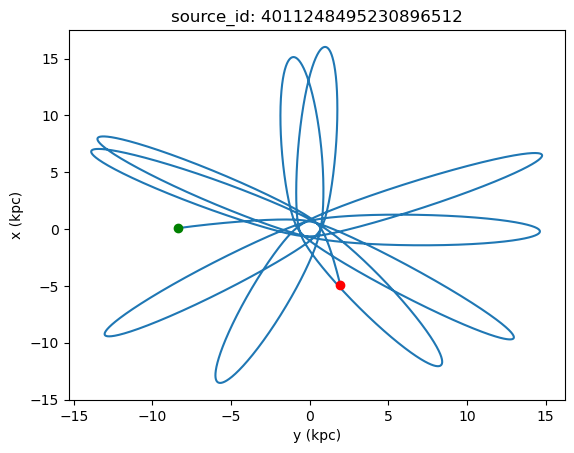

In [18]:
# Plotting on XY plane
plt.plot(X, Y)
plt.plot(X[0], Y[0], 'go')
plt.plot(X[len(X) - 1], Y[len(Y) - 1], 'ro')
plt.title('source_id: ' + str(halo_star['source_id'].iloc[0]))
plt.xlabel('y (kpc)')
plt.ylabel('x (kpc)')
plt.show()

In [24]:
# For bulge component star, we define a star with x < 3 kpc is a halo component star
bulge_star = data.loc[data['x'] > -3]
bulge_star

,index,source_id,ra,dec,parallax,parallax_over_error,pmra,pmra_error,pmdec,pmdec_error,...,radial_velocity_error,x,y,z,U,V,W,dU,dV,dW
12487,520328,4050413885397336320,271.145629,-28.896850,0.187154,8.298571,-5.627396,0.024741,-4.355131,0.017107,...,0.576035,-2.793665,0.197951,-0.324947,-248.983935,6.994931e+01,9.598692e+01,5.308440e+00,1.265435e+01,1.337965e+01
12624,519297,4062860292659033984,271.860974,-27.884395,0.183993,7.987744,1.656908,0.028033,-7.920342,0.018847,...,0.388698,-2.707829,0.314149,-0.336432,-358.592107,6.580107e+01,-1.034410e+02,5.506430e+00,5.065030e+00,7.996093e+00
12808,519246,4056433303630337024,267.579231,-29.923816,0.189209,7.649405,-3.748546,0.028823,-10.789432,0.017373,...,1.055077,-2.838771,-0.029249,-0.120552,-433.624417,-3.219641e+01,-3.817705e+01,1.080020e+01,1.903254e+01,1.789185e+01
12870,519290,4068212646503695616,265.234153,-24.653492,0.162650,7.501404,-17.951295,0.026890,-9.394453,0.014483,...,1.856072,-1.991156,0.331907,0.341490,-353.946716,-2.836844e+02,2.874704e+02,1.860618e+01,4.349589e+01,4.780521e+01
13052,518256,4060802865859684352,266.188728,-27.028715,0.189150,7.096028,1.065343,0.032197,-2.318668,0.018909,...,0.972807,-2.837862,0.140920,0.114127,15.208909,2.100441e+02,-4.532667e+01,1.373878e+00,3.496322e+00,4.021995e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16977,513364,4058798005150564608,263.272668,-29.053480,0.000007,0.000085,-3.212768,0.082091,-4.930522,0.054967,...,3.980480,148649.701968,-4044.077043,5478.997064,-113160.552840,-4.149677e+06,1.028197e+04,1.561627e+10,2.829741e+10,2.825271e+10
16978,513402,4064005360944028544,270.284000,-26.345724,0.000008,0.000078,-5.857345,0.122159,-8.689686,0.081379,...,4.558952,122861.922306,8541.440843,-3852.682416,437676.928893,-6.088327e+06,4.602749e+05,2.121266e+10,4.649784e+10,4.670901e+10
16979,513327,4058601742331371008,262.387990,-30.350116,0.000005,0.000063,-3.008806,0.079397,-4.278527,0.059025,...,6.241204,209802.196941,-11234.451853,7495.850116,-283945.181866,-5.202858e+06,1.524260e+05,2.727896e+10,4.791038e+10,4.807799e+10
16980,513318,4067889424421226112,266.044676,-25.566712,0.000004,0.000060,-3.870593,0.082972,-4.975802,0.050324,...,3.587962,234009.143786,11064.447798,7713.274394,303105.380528,-6.955112e+06,7.747464e+05,3.367926e+10,7.119955e+10,7.244131e+10


In [25]:
x = bulge_star['x'].iloc[4] * u.kpc
y = bulge_star['y'].iloc[4] * u.kpc
z = bulge_star['z'].iloc[4] * u.kpc
U = bulge_star['U'].iloc[4] * u.kilometer / (u.second)
V = bulge_star['V'].iloc[4] * u.kilometer / (u.second)
W = bulge_star['W'].iloc[4] * u.kilometer / (u.second)
Ax = 0 * u.kilometer / (u.s)**2
Ay = 0 * u.kilometer / (u.s)**2
Az = 0 * u.kilometer / (u.s)**2
X, Y, Z = [x.value], [y.value], [z.value]
R = [np.sqrt(x.value**2 + y.value**2)]
             
dt = 5E3 * u.yr                                            # Timestep of the simulation
t = 0 * u.yr                                               # Set t0 = 0

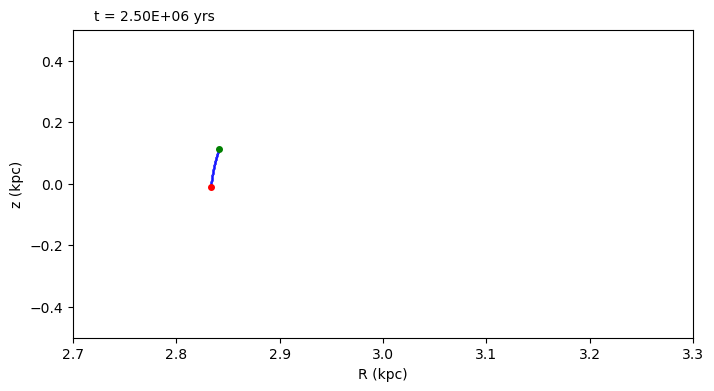

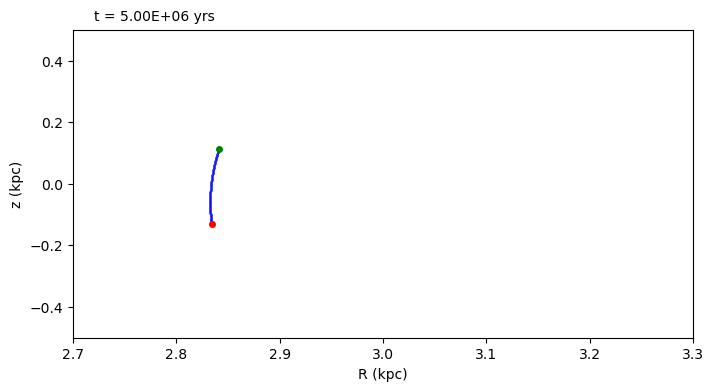

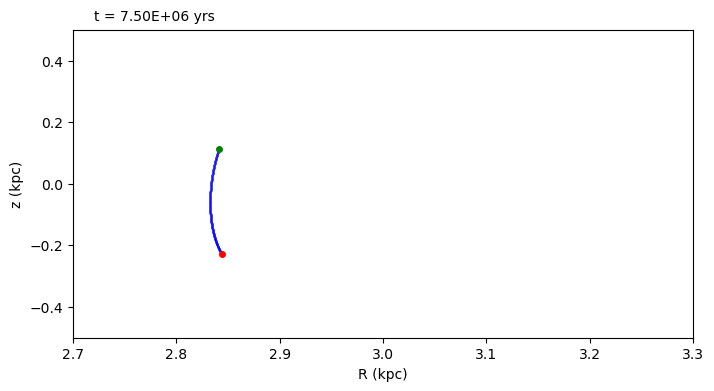

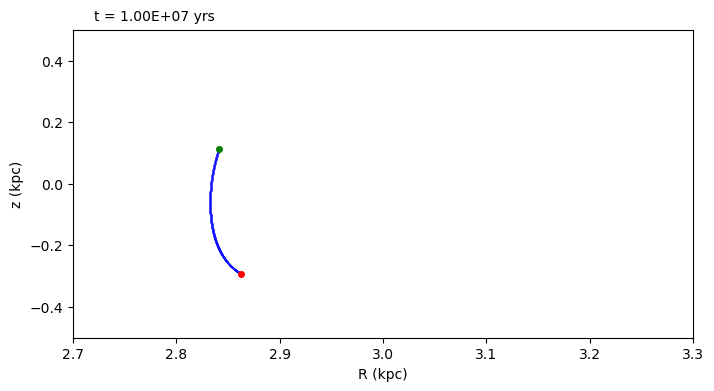

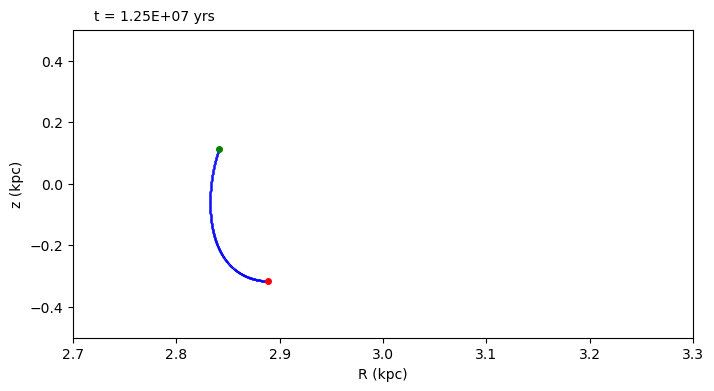

...

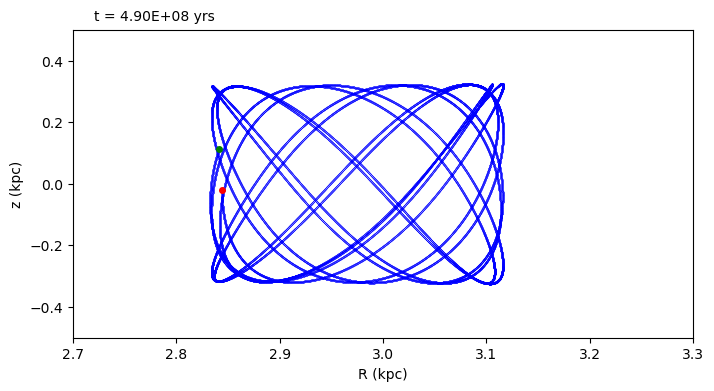

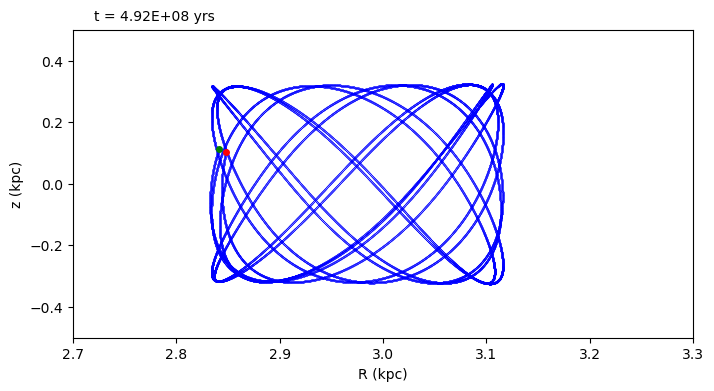

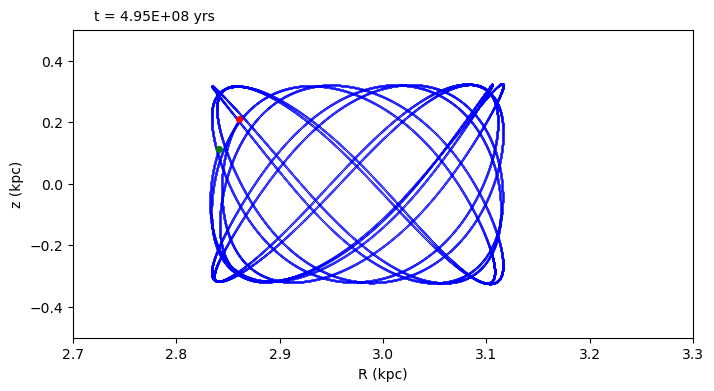

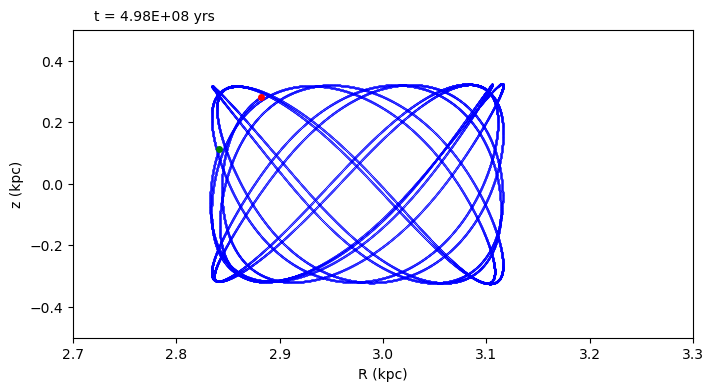

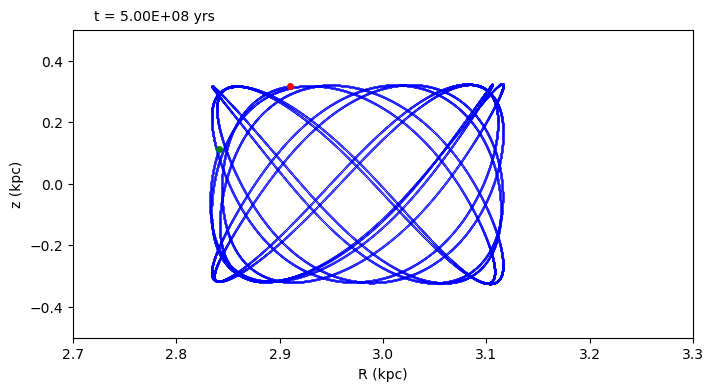

Wall time: 6h 56min 51s


In [26]:
%%time
# The simulation uses second order approximation of gradient
# This implies the simulation will result large error for large dt 
# Result also may deviates at large enough t
# Another note: at dt constant, typically error increase as U, V, W increase
#               choose smaller dt for larger U, V, W

# WARNING
# Long simulation ahead, this'll take quite some time

count = 0
while t.value <= 5E8:                                        # We do the simulation for 0.5 Gyr
    dx = (U*dt).decompose() + (0.5*Ax*dt**2).decompose()
    dy = (V*dt).decompose() + (0.5*Ay*dt**2).decompose()
    dz = (W*dt).decompose() + (0.5*Az*dt**2).decompose()
    Ax = -((((totpot(x + dx/2, y, z)) - (totpot(x - dx/2, y, z))) / dx) + ((totpot(x + dx/2, y, z) - 2*totpot(x, y, z) + totpot(x - dx/2, y, z))/ dx)).decompose()
    Ay = -((((totpot(x, y + dy/2, z)) - (totpot(x, y - dy/2, z))) / dy) + ((totpot(x, y + dy/2, z) - 2*totpot(x, y, z) + totpot(x, y - dy/2, z))/ dy)).decompose()
    Az = -((((totpot(x, y, z + dz/2)) - (totpot(x, y, z - dz/2))) / dz) + ((totpot(x, y, z + dz/2) - 2*totpot(x, y, z) + totpot(x, y, z - dz/2))/ dz)).decompose()
    U += (Ax*dt).decompose()
    V += (Ay*dt).decompose()
    W += (Az*dt).decompose()
    x += dx.decompose()
    y += dy.decompose()
    z += dz.decompose()
    X.append(x.value)
    Y.append(y.value)
    Z.append(z.value)
    R.append(np.sqrt(x.value**2 + y.value**2))
    t += dt
    count += 1

    if count%500 == 0:                                        # Plotting frequency
        fig, ax = plt.subplots(figsize=(8, 4))
        plt.plot(R, Z, 'bo', markersize=.1, alpha=.5)
        plt.plot(np.sqrt(x.value**2 + y.value**2), z.value, 'ro', markersize=4)
        plt.plot(R[0], Z[0], 'go', markersize=4)
        plt.text(2.72, 0.530, 't = ' + str('%.2E' % Decimal(t.value)) + ' yrs')
        plt.xlim(2.7, 3.3)
        plt.ylim(-0.5, 0.5)
        plt.xlabel('R (kpc)')
        plt.ylabel('z (kpc)')
        plt.show()

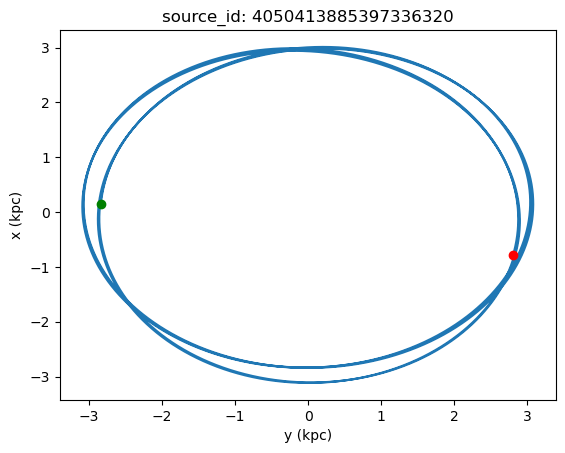

In [28]:
# Plotting on XY plane
plt.plot(X, Y)
plt.plot(X[0], Y[0], 'go')
plt.plot(X[len(X) - 1], Y[len(Y) - 1], 'ro')
plt.title('source_id: ' + str(bulge_star['source_id'].iloc[0]))
plt.xlabel('y (kpc)')
plt.ylabel('x (kpc)')
plt.show()